# <font color= #555555> <font size = 5> Abstract </font>

<font color= #6B6B6B> <font size = 2> This document was elaborated by **if_fernandofg@outlook.com**, as to answer the question *Which is going to be the close price for a determined asset on a determined time?* </font> 

# <font color= #6B6B6B> <font size = 6> 0. Libraries and Dependencies </font>

<hr style="border:0.02in solid gray"> </hr>

# <font color= #6B6B6B> <font size = 5> 0.1 Libraries </font> <font color= #555555>

To run this notebook it is necessary to have installed and/or in the _requirements.txt_ file the next libraries:

- pandas >= 1.1.1 
- numpy >= 1.19.5
- jupyter >= 1.0.0
- plotly >= 5.3.1
- tensorflow >= 2.7.0
- keras >= 2.7.0
- ccxt >= 1.64.28

# <font color= #6B6B6B> <font size = 5> 0.2 Dependencies </font> <font color= #555555>

In order to run this notebook it is necessary to have the next archives and/or dependencies:

In [1]:
# Dependencies

# System
import os
import sys
import traceback

# Math and DS
import numpy as np
import pandas as pd
from pandas.plotting import autocorrelation_plot

# Dates and time
from datetime import datetime, date, timedelta

# ML libraries
import tensorflow as tf
keras = tf.keras

# Data obtention
import ccxt # CryptoCurrency eXchange Trading Library https://github.com/ccxt/ccxt

# Visualizations
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Support for type hints
from typing import Dict


<br>

# <font color= #6B6B6B> <font size = 6> 1. Data </font>

<hr style="border:0.02in solid gray"> </hr>

# <font color= #6B6B6B> <font size = 5> 1.1 Data Fetching </font> <font color= #555555>

In [2]:
def fetch_data(
    exchange_name: str, symbol: str, dt_since: datetime, 
    config: Dict = {}, timeframe: str = '1h', folder_name: str = 'data', 
    enable_log: bool = True, enforce: bool = True, load_df: bool = True) -> None:
    '''
    Fetch candles data OHLCV from exchange, and load it to a csv file.
    
    Inputs
    ------
    exchange_name: str
        Exchange name as shown in ccxt. i.e. "binance"
    symbol: str
        Symbol used to fetch data inside exchange. i.e. "ADAUSDT"
    dt_since: datetime
        Date for start fetching data since. i.e. datetime(2021,1,1)
    config: dict
        Explicit configuration for exchange inside ccxt. i.e. {"verbose": True}
    timeframe: str
        Timeframe for candles window. i.e. "1h"
    '''
    try:

        # Create file name from inputs
        file_name = f'{exchange_name}_{symbol}_{timeframe}.csv'

        # Load exchange 
        exchange = getattr(ccxt, exchange_name)(config)
        # Load exchange markets
        exchange.load_markets()

        # Current datetime 
        dt_now = datetime.now()

        # Load timestamp datetimes
        now = int(dt_now.timestamp() * 1000)
        since = int(dt_since.timestamp() * 1000)

        # Check if folder already exists, if not, create 
        if not os.path.exists(folder_name):
            os.mkdir(folder_name)

        # Check if file already exists, if not, create 
        if not os.path.exists(f'{folder_name}/{file_name}') or enforce:
            init_df = pd.DataFrame({}, columns=['Time','Open','High','Low','Close','Volume'])
            init_df.to_csv(f'{folder_name}/{file_name}', mode='w', index=False)

            # Start loop for data obtention
            while since < now:
                candles = exchange.fetch_ohlcv(
                    symbol = symbol, 
                    timeframe = timeframe, 
                    since = since, 
                    limit = 1000)
                if len(candles) <= 1:
                    break
                since = candles[-1][0] + 1
                
                # Write into csv
                pd.DataFrame(candles).to_csv(f'{folder_name}/{file_name}', mode='a', header=False, index=False)

                if enable_log:
                    print(f'Currently on date {datetime.fromtimestamp(since/1000)} of {dt_now}')
                    
            if enable_log:
                print(f'Finished fetching data on: {folder_name}/{file_name}')
            
                    
        # if file already exists and enforce option inactive
        else:
            print(f'file {file_name} already exists on folder {folder_name}')
            
    except Exception as e:
        print(f'Failed fetching data @fetch_data. Error: {repr(e)}. Traceback: {traceback.format_exc()}')

In [3]:
# Data gathering
exchange_name = 'binance'
symbol = 'ADAUSDT'
timeframe = '5m'
dt_since = datetime(2021,3,1)
enable_log = True
enforce = False
folder_name = 'data'
config = {}


# Fetch data
fetch_data(exchange_name=exchange_name, symbol=symbol, timeframe=timeframe, dt_since=dt_since, enforce=False)

file binance_ADAUSDT_5m.csv already exists on folder data


# <font color= #6B6B6B> <font size = 5> 1.2 Data Preprocessing </font> <font color= #555555>

In [4]:
# Load data from csv file
df = pd.read_csv(f'{folder_name}/{exchange_name}_{symbol}_{timeframe}.csv')
df['Time'] = df['Time'].apply(lambda x: datetime.fromtimestamp(x/1000))
df.set_index('Time', inplace=True)
df

,Open,High,Low,Close,Volume
Time,,,,,
2021-03-01 00:00:00,1.26549,1.26782,1.25740,1.26090,2321193.7
2021-03-01 00:05:00,1.26065,1.26167,1.25560,1.26023,2487111.7
2021-03-01 00:10:00,1.25986,1.26228,1.25805,1.26098,1037352.8
2021-03-01 00:15:00,1.26098,1.26538,1.26007,1.26457,1025082.8
2021-03-01 00:20:00,1.26457,1.26462,1.25632,1.25820,1601067.2
...,...,...,...,...,...
2022-02-13 22:10:00,1.02900,1.03200,1.02900,1.03200,84278.8
2022-02-13 22:15:00,1.03200,1.03200,1.02900,1.03000,112485.8
2022-02-13 22:20:00,1.02900,1.03200,1.02900,1.02900,259757.7


In [5]:
# Show data info
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 100601 entries, 2021-03-01 00:00:00 to 2022-02-13 22:30:00
Data columns (total 5 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Open    100601 non-null  float64
 1   High    100601 non-null  float64
 2   Low     100601 non-null  float64
 3   Close   100601 non-null  float64
 4   Volume  100601 non-null  float64
dtypes: float64(5)
memory usage: 4.6 MB


In [6]:
# Will focus on Close column
series = df['Close']
series

Time
2021-03-01 00:00:00    1.26090
2021-03-01 00:05:00    1.26023
2021-03-01 00:10:00    1.26098
2021-03-01 00:15:00    1.26457
2021-03-01 00:20:00    1.25820
                        ...   
2022-02-13 22:10:00    1.03200
2022-02-13 22:15:00    1.03000
2022-02-13 22:20:00    1.02900
2022-02-13 22:25:00    1.03100
2022-02-13 22:30:00    1.02900
Name: Close, Length: 100601, dtype: float64

In [7]:
# Quick series info
series.describe()

count    100601.000000
mean          1.616749
std           0.483269
min           0.931000
25%           1.236000
50%           1.419000
75%           2.016000
max           3.095000
Name: Close, dtype: float64

# <font color= #6B6B6B> <font size = 5> 1.3 Data Visualization </font> <font color= #555555>

In [8]:
# Create figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Scatter(x=series.index, y=series.values, name=f"Closing {symbol} Prices",
               line={'color': '#1B70F0'}),
    secondary_y=False,
)

rolling_window = 6
fig.add_trace(
    go.Scatter(
        x=series.index, 
        y=series.rolling(window=rolling_window).mean(), 
        name=f"{symbol} {rolling_window} Rolling Mean",
        line={
            'color': '#071d49', 
            "width": 0.5
        }),
    secondary_y=True,
)

# Add figure title  
fig.update_layout(
    title_text=f"{symbol} prices",
    xaxis=dict(showline=True,showgrid=False),
    plot_bgcolor='#f8fafc',
    font_color='#737c90'
)
# Set x-axis title
fig.update_xaxes(title_text="Date")

# Set y-axes titles
fig.update_yaxes(title_text=f"Closing {symbol} Prices", secondary_y=False)
fig.update_yaxes(title_text=f"{symbol} {rolling_window} Rolling Mean (black)", secondary_y=True)

In [9]:
# Plot Close histogram
fig = px.histogram(series)

# Add figure title
fig.update_layout(
    title_text=f"{symbol} histogram"
)

# Set x-axis title
fig.update_xaxes(title_text="Close prices")

# Set y-axes titles
fig.update_yaxes(title_text="Count")

# Update Layout
fig.update_layout(xaxis=dict(showline=True,showgrid=False),
                  plot_bgcolor='#f8fafc',
                  font_color='#737c90'
                 )
fig.show()

In [10]:
# Plot Close boxplot 
fig = px.box(series)

# Add figure title
fig.update_layout(
    title_text=f"{symbol} bosplot"
)

# Set x-axis title
fig.update_xaxes(title_text="Feature")

# Set y-axes titles
fig.update_yaxes(title_text="Price (USDT)")

#Update Layout
fig.update_layout(xaxis=dict(showline=True,showgrid=False),
                  plot_bgcolor='#f8fafc',
                  font_color='#737c90'
                 )

fig.show()

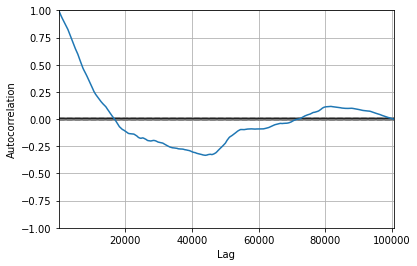

In [11]:
# Quantify strength of the correlation between data an its own lags
autocorrelation_plot(series)
plt.show()

# <font color= #6B6B6B> <font size = 5> 1.4 Data Split </font> <font color= #555555>

In [12]:
# Closing prices values
values = series.values

# Take 80% data for train, 20% for validation
split_val = int(len(values) * 0.8)

# Split into train and validation
time_train = series.index[:split_val]
x_train = values[:split_val]

time_valid = series.index[split_val:]
x_valid = values[split_val:]

print(f'Total values: {len(values)}')
print(f'Train values: {len(x_train)}')
print(f'Validation values: {len(x_valid)}')

Total values: 100601
Train values: 80480
Validation values: 20121


<br>

# <font color= #6B6B6B> <font size = 6> 2. Models </font>

<hr style="border:0.02in solid gray"> </hr>

# <font color= #6B6B6B> <font size = 5> 2.1 General Neural Networks Utilities </font> <font color= #555555>

In [13]:
class ResetStatesCallback(keras.callbacks.Callback):
    def on_epoch_begin(self, epoch, logs):
        self.model.reset_states()

In [14]:
def seq_w_dataset(series, window_size, batch_size=32, shuffle_buffer=1000):
    '''Create sequential window dataset'''
    series = tf.expand_dims(series, axis=-1)
    ds = tf.data.Dataset.from_tensor_slices(series)
    ds = ds.window(window_size + 1, shift=1, drop_remainder=True)
    ds = ds.flat_map(lambda w: w.batch(window_size + 1))
    ds = ds.shuffle(shuffle_buffer)
    ds = ds.map(lambda w: (w[:-1], w[1:]))
    return ds.batch(batch_size).prefetch(1)

In [30]:
def model_forecast(model, series, window_size):
    ds = tf.data.Dataset.from_tensor_slices(series)
    ds = ds.window(window_size, shift=1, drop_remainder=True)
    ds = ds.flat_map(lambda w: w.batch(window_size))
    ds = ds.batch(32).prefetch(1)
    forecast = model.predict(ds)
    return forecast

# <font color= #6B6B6B> <font size = 5> 2.2 1D-Convolutional Layers </font> <font color= #555555>

In [16]:
# First train data to obtain best learning rate
# Select a window size for CNN
window_size = 24 # One day window

# Clear keras session
keras.backend.clear_session()

# Create train set
train_set = seq_w_dataset(x_train, window_size,
                                   batch_size=128)

model = keras.models.Sequential([
  keras.layers.Conv1D(filters=32, kernel_size=5,
                      strides=1, padding="causal",
                      activation="relu",
                      input_shape=[None, 1]),
  keras.layers.LSTM(32, return_sequences=True),
  keras.layers.LSTM(32, return_sequences=True),
  keras.layers.Dense(1),
  keras.layers.Lambda(lambda x: x * 200)
])

lr_schedule = keras.callbacks.LearningRateScheduler(
    lambda epoch: 1e-8 * 10**(epoch / 20))
optimizer = keras.optimizers.SGD(learning_rate=1e-8, momentum=0.9)
model.compile(loss=keras.losses.Huber(),
              optimizer=optimizer,
              metrics=["mae"])
history = model.fit(train_set, epochs=100, callbacks=[lr_schedule])

2022-02-14 00:04:05.420165: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Epoch 1/100
629/629 [==============================] - 12s 16ms/step - loss: 1.8879 - mae: 2.3430 - lr: 1.0000e-08
Epoch 2/100
629/629 [==============================] - 10s 16ms/step - loss: 1.9115 - mae: 2.3723 - lr: 1.1220e-08
Epoch 3/100
629/629 [==============================] - 10s 17ms/step - loss: 1.8084 - mae: 2.2674 - lr: 1.2589e-08
Epoch 4/100
629/629 [==============================] - 10s 15ms/step - loss: 1.6971 - mae: 2.1542 - lr: 1.4125e-08
Epoch 5/100
629/629 [==============================] - 10s 15ms/step - loss: 1.5803 - mae: 2.0352 - lr: 1.5849e-08
Epoch 6/100
629/629 [==============================] - 10s 15ms/step - loss: 1.4604 - mae: 1.9112 - lr: 1.7783e-08
Epoch 7/100
629/629 [==============================] - 10s 16ms/step - loss: 1.3402 - mae: 1.7850 - lr: 1.9953e-08
Epoch 8/100
629/629 [==============================] - 10s 16ms/step - loss: 1.2231 - mae: 1.6623 - lr: 2.2387e-08
Epoch 9/100
629/629 [==============================] - 10s 16ms/step - loss: 1.1

629/629 [==============================] - 12s 19ms/step - loss: 0.7284 - mae: 1.2256 - lr: 3.1623e-05
Epoch 72/100
629/629 [==============================] - 11s 18ms/step - loss: 0.0564 - mae: 0.1520 - lr: 3.5481e-05
Epoch 73/100
629/629 [==============================] - 11s 18ms/step - loss: 0.0021 - mae: 0.0419 - lr: 3.9811e-05
Epoch 74/100
629/629 [==============================] - 11s 18ms/step - loss: 0.0020 - mae: 0.0399 - lr: 4.4668e-05
Epoch 75/100
629/629 [==============================] - 11s 18ms/step - loss: 0.0019 - mae: 0.0386 - lr: 5.0119e-05
Epoch 76/100
629/629 [==============================] - 11s 18ms/step - loss: 0.0585 - mae: 0.1803 - lr: 5.6234e-05
Epoch 77/100
629/629 [==============================] - 11s 18ms/step - loss: 1.4488 - mae: 1.9413 - lr: 6.3096e-05
Epoch 78/100
629/629 [==============================] - 12s 18ms/step - loss: 1.2850 - mae: 1.7849 - lr: 7.0795e-05
Epoch 79/100
629/629 [==============================] - 12s 19ms/step - loss: 0.3217 

(1e-08, 0.0001, 0.0, 0.1)

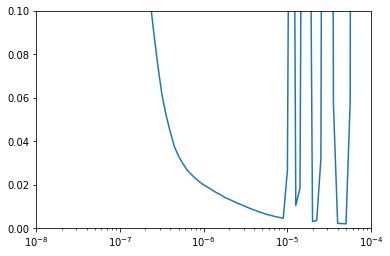

In [21]:
# Plot loss metric for best model Learning Rate selection
plt.semilogx(history.history["lr"], history.history["loss"])
plt.axis([1e-8, 1e-4, 0, 0.1])

In [26]:
# Select Learning Rate to use
best_lr = 5e-6

# Check on models folder
model_folder = 'models'
if not os.path.exists(model_folder):
    os.mkdir(model_folder)
    
# Select Model name to use for saving
model_name = f"my_{symbol}_{timeframe}_model.h5"

In [35]:
window_size = 24 # One day window

# Clear keras session
keras.backend.clear_session()

# Create train set
train_set = seq_w_dataset(x_train, 
                          window_size,
                          batch_size=128)

# Create validation set
valid_set = seq_w_dataset(x_valid, 
                          window_size,
                          batch_size=128)

model = keras.models.Sequential()
model.add(keras.layers.InputLayer(input_shape=[None, 1]))
for dilation_rate in (1, 2, 4, 8, 16, 32):
    model.add(
      keras.layers.Conv1D(filters=32,
                          kernel_size=2,
                          strides=1,
                          dilation_rate=dilation_rate,
                          padding="causal",
                          activation="relu")
    )
    
model.add(keras.layers.Conv1D(filters=1, kernel_size=1))
optimizer = keras.optimizers.Adam(learning_rate=best_lr)
model.compile(loss=keras.losses.Huber(),
              optimizer=optimizer,
              metrics=["mae"])

model_checkpoint = keras.callbacks.ModelCheckpoint(
    f'{model_folder}/{model_name}', save_best_only=True)
early_stopping = keras.callbacks.EarlyStopping(patience=20)
history = model.fit(train_set, epochs=100,
                    validation_data=valid_set,
                    callbacks=[early_stopping, model_checkpoint])

Epoch 1/100
629/629 [==============================] - 12s 18ms/step - loss: 1.1735 - mae: 1.6735 - val_loss: 0.6789 - val_mae: 1.1788
Epoch 2/100
629/629 [==============================] - 12s 18ms/step - loss: 1.0758 - mae: 1.5758 - val_loss: 0.5827 - val_mae: 1.0812
Epoch 3/100
629/629 [==============================] - 12s 18ms/step - loss: 0.9117 - mae: 1.4112 - val_loss: 0.4300 - val_mae: 0.9149
Epoch 4/100
629/629 [==============================] - 11s 18ms/step - loss: 0.6590 - mae: 1.1472 - val_loss: 0.2495 - val_mae: 0.6582
Epoch 5/100
629/629 [==============================] - 11s 17ms/step - loss: 0.3891 - mae: 0.7951 - val_loss: 0.1354 - val_mae: 0.4065
Epoch 6/100
629/629 [==============================] - 11s 17ms/step - loss: 0.2465 - mae: 0.5492 - val_loss: 0.1033 - val_mae: 0.3563
Epoch 7/100
629/629 [==============================] - 11s 17ms/step - loss: 0.1943 - mae: 0.4724 - val_loss: 0.0854 - val_mae: 0.3179
Epoch 8/100
629/629 [==============================] - 

629/629 [==============================] - 12s 19ms/step - loss: 5.1898e-04 - mae: 0.0221 - val_loss: 0.0011 - val_mae: 0.0394
Epoch 62/100
629/629 [==============================] - 12s 19ms/step - loss: 4.6870e-04 - mae: 0.0209 - val_loss: 0.0010 - val_mae: 0.0367
Epoch 63/100
629/629 [==============================] - 12s 19ms/step - loss: 4.2275e-04 - mae: 0.0198 - val_loss: 9.2353e-04 - val_mae: 0.0344
Epoch 64/100
629/629 [==============================] - 12s 19ms/step - loss: 3.8279e-04 - mae: 0.0187 - val_loss: 8.2621e-04 - val_mae: 0.0321
Epoch 65/100
629/629 [==============================] - 11s 18ms/step - loss: 3.4706e-04 - mae: 0.0177 - val_loss: 7.3955e-04 - val_mae: 0.0299
Epoch 66/100
629/629 [==============================] - 11s 18ms/step - loss: 3.1457e-04 - mae: 0.0168 - val_loss: 6.6500e-04 - val_mae: 0.0280
Epoch 67/100
629/629 [==============================] - 12s 18ms/step - loss: 2.8523e-04 - mae: 0.0158 - val_loss: 5.9862e-04 - val_mae: 0.0262
Epoch 68/100


In [36]:
model = keras.models.load_model(f'{model_folder}/{model_name}')

In [37]:
cnn_forecast = model_forecast(model, values[..., np.newaxis], window_size)
cnn_forecast = cnn_forecast[split_val - window_size:-1, -1, 0]

In [39]:
# Create figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Scatter(
        x=time_valid, 
        y=x_valid, 
        name=f"Closing {symbol} Prices",
        line={
            'color': '#1B70F0'
        }),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(
        x=time_valid, 
        y=cnn_forecast, 
        name=f"{symbol} Predicted Prices",
        line={
            'color': '#071d49', 
            "width": 0.5
        }),
    secondary_y=True,
)

# Add figure title  
fig.update_layout(
    title_text=f"{symbol} prices",
    xaxis=dict(showline=True,showgrid=False),
    plot_bgcolor='#f8fafc',
    font_color='#737c90'
)
# Set x-axis title
fig.update_xaxes(title_text="Date")

# Set y-axes titles
fig.update_yaxes(title_text=f"Closing {symbol} Prices", secondary_y=False)
fig.update_yaxes(title_text=f"{symbol} Predicted Prices", secondary_y=True)

In [43]:
# MAE metric
mae_metric = keras.metrics.mean_absolute_error(x_valid, cnn_forecast).numpy()
print(f'After train and test, we have a mae of: {mae_metric} USDT on price predictions')

After train and test, we have a mae of: 0.0037622773088514805 USDT on price predictions


<br>

# <font color= #6B6B6B> <font size = 6> 3. Conclusions and Further Work </font>

<font color= #6B6B6B> <font size = 2> After fetching data of a crypto asset with the help of ccxt library which simplifies calls to exchange's APIs, loading set data, generating an EDA, and generating a simple CNN, it can be concluded that the hyperparameters of the neural network would have to be reviewed in greater detail, meaning number of neurons, hidden layers, batch size, and epochs, the path used could obtain good results, however, at the same time it is possible to search for the forecasting of multivariate time series, including parameters such as technical indicators, as well as sentimental analysis, among others, performing a PCA, to seek to reduce the dimensionality of the dataset. On the other hand, once a model has been found that works as an accurate tool for use within a strategy, it would be wise to implement Websockets APIs in order to obtain real-time data from the exchange. </font> 

<hr>